In [32]:
import sys
import time
import numpy as np
from utils import * #check util.py file for extra functionalities 
import random
from collections import deque
import numpy as np
import torch
import torch.nn as nn
import torch.optim as optim
from torch.utils.tensorboard import SummaryWriter



#initialized DQN Network and Experience Replay for training

class Model(nn.Module):
    def __init__(self, state_dim, action_dim):
        super(Model, self).__init__()
        self.fc1 = nn.Linear(state_dim, out_features=64)
        self.fc2 = nn.Linear(64, 32)
        self.fc3 = nn.Linear(32, 8)
        self.fc4 = nn.Linear(8, action_dim)
        self.relu = nn.ReLU()

    def forward(self, x):
        x = self.relu(self.fc1(x))
        x = self.relu(self.fc2(x))
        x = self.relu(self.fc3(x))
        x = self.fc4(x)
        return x






class Agent(Portfolio):
    def __init__(self, state_dim, balance, is_eval=False, model_name=""):
        super().__init__(balance=balance)
        #initializing all the hyperparameters
        self.model_type = 'DQN'
        self.state_dim = state_dim
        self.action_dim = 3  # hold, buy, sell
        self.memory = deque(maxlen=100)
        self.buffer_size = 60

        self.gamma = 0.95
        self.epsilon = 1.0  #initial exploration rate
        self.epsilon_min = 0.01  #minimum exploration rate
        self.epsilon_decay = 0.995 #decrease exploration rate as the agent becomes good at trading
        self.is_eval = is_eval

        #initialize the model
        self.model = self.build_model()
        if is_eval:
            self.model.load_state_dict(torch.load(f'models/{model_name}.pt' ))

        self.writer = SummaryWriter(log_dir='./logs/DQN_tensorboard')
        self.optimizer = optim.Adam(self.model.parameters(), lr=0.01)
        self.criterion = nn.MSELoss()
    
    
    def build_model(self):
        return Model(self.state_dim, self.action_dim)

    #keras bekar never use 
    # def model(self):
    #     model = Sequential()
    #     model.add(Dense(units=64, input_dim=self.state_dim, activation='relu'))
    #     model.add(Dense(units=32, activation='relu'))
    #     model.add(Dense(units=8, activation='relu'))
    #     model.add(Dense(self.action_dim, activation='softmax'))
    #     model.compile(loss='mse', optimizer=Adam(learning_rate=0.01))
    #     return model



    #reset the portfolio and everything to begin a new episode
    def reset(self):
        self.reset_portfolio()
        self.epsilon = 1.0 #reset exploration rate


    #add data of every run for experience replay to memory
    def remember(self, state, action, reward, next_state, done):
        self.memory.append((state, action, reward, next_state, done))

    
    #perform an action by inputting the state_tensor to the DQN NN
    def act(self, state):
        if not self.is_eval and np.random.rand() <= self.epsilon:
            return random.randrange(self.action_dim)
        state_tensor = torch.FloatTensor(state).unsqueeze(0)  #convert state to tensor and add batch dimension
        options = self.model(state_tensor)
        return np.argmax(options.detach().numpy())


    
    #experience replay to run on prev plays ,calculate loss and update the NN
    def experience_replay(self):
    
        mini_batch = [self.memory[i] for i in range(len(self.memory) - self.buffer_size +1, len(self.memory))]
        
        states, actions, rewards, next_states, dones = zip(*mini_batch)
        
        states = torch.FloatTensor(states)
        actions = torch.LongTensor(actions)
        rewards = torch.FloatTensor(rewards)
        next_states = torch.FloatTensor(next_states)
        dones = torch.FloatTensor(dones)

        q_values = self.model(states)
        next_q_values = self.model(next_states)

        q_values = q_values.squeeze(1) 
        next_q_values = next_q_values.squeeze(1)
        
        # print(q_values)
        # print(q_values.shape )
        # print(actions.shape)
        q_value = q_values.gather(1, actions.view(-1, 1)).squeeze(1)
        next_q_value = next_q_values.max(1)[0]
        expected_q_value = rewards + self.gamma * next_q_value * (1 - dones)

        loss = self.criterion(q_value, expected_q_value.detach())

        self.optimizer.zero_grad()
        loss.backward()
        self.optimizer.step()

        if self.epsilon > self.epsilon_min:
            self.epsilon *= self.epsilon_decay

        self.writer.add_scalar('Loss/train', loss.item())
        
        return loss.item()

    



Episode : 1
2
Step: 1	Hold signal: -0.03947 	Buy signal: -0.1773 	Sell signal: 0.1629
0
Step: 2	Hold signal: -0.0412 	Buy signal: -0.1773 	Sell signal: 0.1604
'Hold' is an exploration.
0
Step: 3	Hold signal: -0.03916 	Buy signal: -0.1773 	Sell signal: 0.1634
'Hold' is an exploration.
2
Step: 4	Hold signal: -0.03657 	Buy signal: -0.1774 	Sell signal: 0.1671
1
Step: 5	Hold signal: -0.03856 	Buy signal: -0.1773 	Sell signal: 0.1642
'Buy' is an exploration.
2
Step: 6	Hold signal: -0.03453 	Buy signal: -0.1774 	Sell signal: 0.17
2
Step: 7	Hold signal: -0.02498 	Buy signal: -0.2125 	Sell signal: 0.03468
1
Step: 8	Hold signal: -0.03605 	Buy signal: -0.1774 	Sell signal: 0.1678
'Buy' is an exploration.
0
Step: 9	Hold signal: -0.03474 	Buy signal: -0.1774 	Sell signal: 0.1697
'Hold' is an exploration.
0
Step: 10	Hold signal: -0.01878 	Buy signal: -0.2055 	Sell signal: 0.04816
'Hold' is an exploration.
0
Step: 11	Hold signal: -0.03941 	Buy signal: -0.2206 	Sell signal: -0.01517
'Hold' is an expl

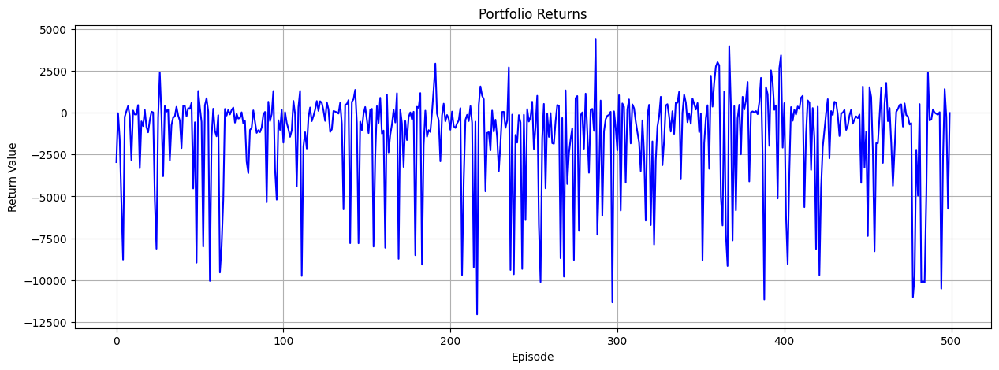

In [33]:
#main training code block here

model_name = 'DQN'
# stock_name = input('Stock Name: ')
stock_name = 'GSPC_2018'
window_size = 10
num_episode = 500
initial_balance = 100000

#get the closing price for a particular day
stock_prices = stock_close_prices(key=stock_name)
trading_period = len(stock_prices) - 1
returns_across_episodes = []
num_experience_replay = 0
action_dict = {0: 'Hold', 1: 'Buy', 2: 'Sell'}


# model = importlib.import_module(f'agents.{model_name}')
agent = Agent(state_dim=window_size + 3, balance=initial_balance)


#the action to hold a stock
def hold(actions):
    #encourage selling for profit and liquidity
    actions = actions.reshape(-1)
    next_probable_action = np.argsort(actions)[1]
    if next_probable_action == 2 and len(agent.inventory) > 0:
        max_profit = stock_prices[t] - min(agent.inventory)
        if max_profit > 0:
            sell(t)
            actions[next_probable_action] = 1 #reset this action's value to the highest
            actions.reshape(1,3)
            return 'Hold', actions


#action to buy a stock
def buy(t):
    if agent.balance > stock_prices[t]:
        agent.balance -= stock_prices[t]
        global reward 

        #reward the model if it identifies peaks correctly and buys high
        if ( t>=2 and stock_prices[t] < stock_prices[t-1] and stock_prices[t-1] > stock_prices[t-2] and stock_prices[t] < stock_prices[t-3]):
            reward += 1000

        #add the stock in the memory of the stock
        agent.inventory.append(stock_prices[t])
        return 'Buy: ${:.2f}'.format(stock_prices[t])


#action to sell a stock
def sell(t):

    if len(agent.inventory) > 0:

        agent.balance += stock_prices[t]
        bought_price = agent.inventory.pop()
        profit = stock_prices[t] - bought_price
        global reward
        #reward the model if it maintains a healthy amount of stocks in the portfolio
        if ( agent.balance < agent.initial_portfolio_value/5):
            reward +=2000

        #reward the model if it identifies peaks correctly and tends to sell high        
        if ( t>= 3 and stock_prices[t] < stock_prices[t-1] and stock_prices[t] < stock_prices[t-2] and stock_prices[t] < (stock_prices[t-3]) ):
            reward += 2000
        return 'Sell: ${:.2f} | Profit: ${:.2f}'.format(stock_prices[t], profit)







start_time = time.time()


#main training loop here

for episode in range(1 , num_episode+1):
    print(f'Episode : {episode}')
    
    agent.reset() #see
    state = generate_combined_state(0, window_size, stock_prices, agent.balance, len(agent.inventory))

    for t in range(1, trading_period + 1):
        if t % 100 == 0:
            print(f'\n-------------------Period: {t}/{trading_period}-------------------')

        reward = 0
        next_state = generate_combined_state(t, window_size, stock_prices, agent.balance, len(agent.inventory))
        previous_portfolio_value = len(agent.inventory) * stock_prices[t] + agent.balance
       

        # actions = agent.model.predict(state)[0]
        # action = agent.act(state)

        actions = agent.model(torch.FloatTensor(state).unsqueeze(0)).cpu().detach().numpy()[0]



        action = agent.act(state=state)
        print(action)

        print('Step: {}\tHold signal: {:.4} \tBuy signal: {:.4} \tSell signal: {:.4}'.format(t, actions[0][0], actions[0][1], actions[0][2]))
        if action != np.argmax(actions): print(f"'{action_dict[action]}' is an exploration.")
        if action == 0: #hold
            execution_result = hold(actions=actions)
        if action == 1: #buy
            execution_result = buy(t)      
        if action == 2: #sell
            execution_result = sell(t=t)        

        #print the execution result
        if isinstance(execution_result, tuple):
                actions = execution_result[1]
                execution_result = execution_result[0]
                print(execution_result)
             
        
        current_portfolio_value = len(agent.inventory) * stock_prices[t] + agent.balance
        
        
        unrealized_profit = current_portfolio_value - agent.initial_portfolio_value
        
        #primarily reward is set as the unrealized profit, that is the appreciation in the net-worth
        reward += unrealized_profit
          
        #stores the rpeviosu trades results
        agent.portfolio_values.append(current_portfolio_value)
        agent.return_rates.append((current_portfolio_value - previous_portfolio_value) / previous_portfolio_value)
        
        
        done = True if t == trading_period else False
        
        #add data of every run for experience replay to memory
        agent.remember(state, action, reward, next_state, done)
        state = next_state

        #run the experience replay 
        if len(agent.memory) > agent.buffer_size: #sexy
            num_experience_replay += 1
            loss = agent.experience_replay()
            print('Episode: {}\tLoss: {:.2f}\tAction: {}\tReward: {:.2f}\tBalance: {:.2f}\tNumber of Stocks: {}'.format(episode, loss, action_dict[action], reward, agent.balance, len(agent.inventory)))
            agent.writer.add_scalar('Loss/train', loss, num_experience_replay)
            agent.writer.add_scalar('Portfolio Value/train', current_portfolio_value, num_experience_replay)

        if done:
            portfolio_return = agent.portfolio_values[-1] - agent.initial_portfolio_value
            returns_across_episodes.append(portfolio_return)

        #save the trained model for evaluating the model later 
        if model_name == 'DQN':
            torch.save(agent.model.state_dict(), f'models/DQN_ep{episode}.pt')
                
print('total training time: {0:.2f} min'.format((time.time() - start_time)/60))

#plot the data to get the returns across epidodes on training the data
plot_portfolio_returns_across_episodes(model_name, returns_across_episodes)


10


/tmp/ipykernel_4126/4161191421.py:66: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  self.model.load_state_dict(torch.load(f'models/{model_name}.pt' ))


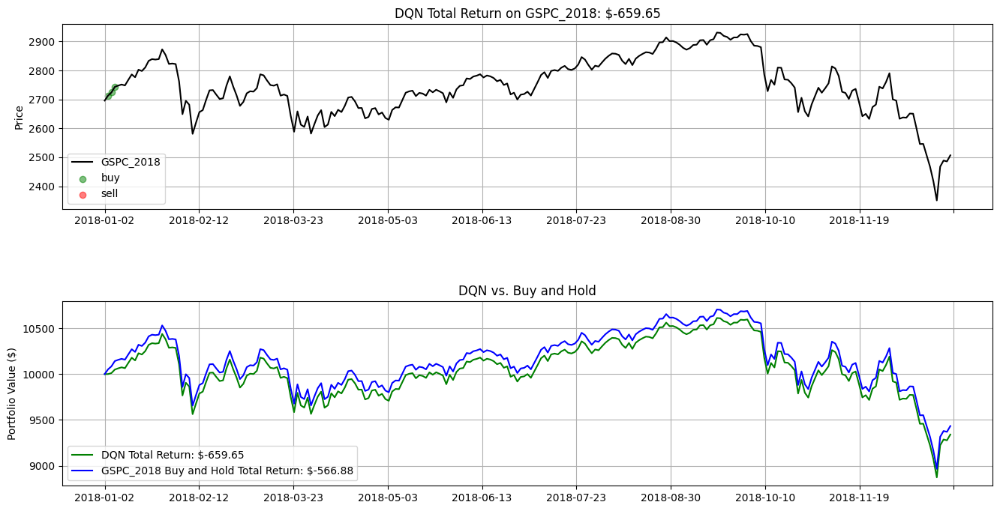

/tmp/ipykernel_4126/4161191421.py:66: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  self.model.load_state_dict(torch.load(f'models/{model_name}.pt' ))


20
30
40


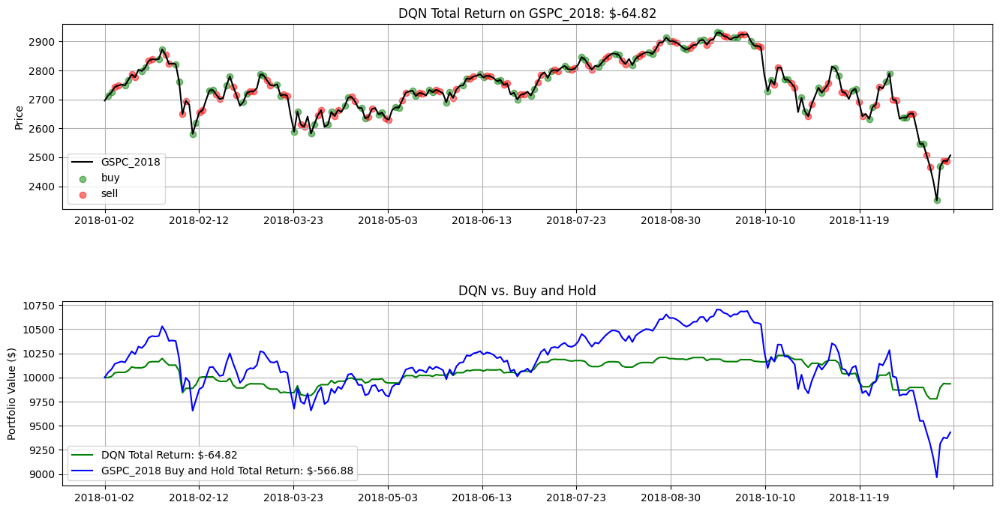

50
60
70
80


/tmp/ipykernel_4126/4161191421.py:66: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  self.model.load_state_dict(torch.load(f'models/{model_name}.pt' ))


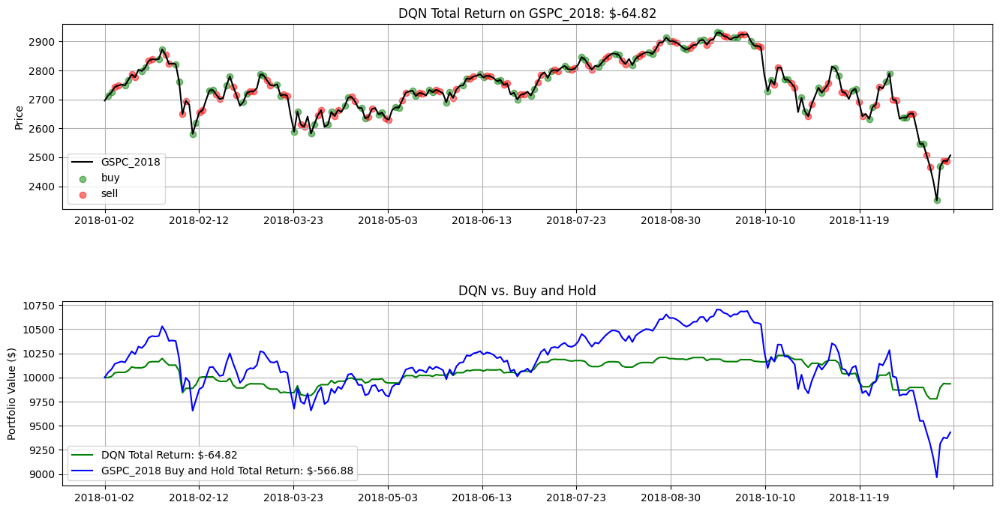

90
100
110
120
130


/tmp/ipykernel_4126/4161191421.py:66: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  self.model.load_state_dict(torch.load(f'models/{model_name}.pt' ))


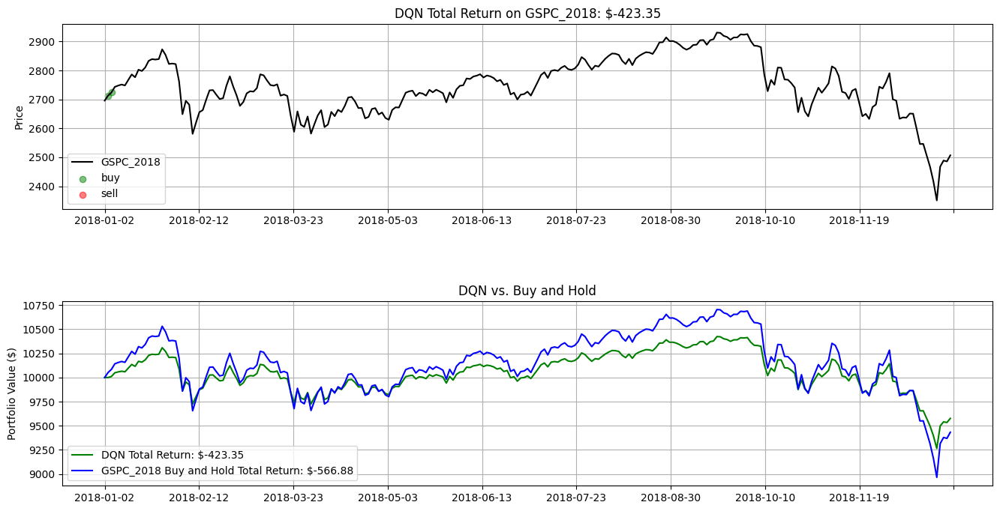

140
150
160
170


/tmp/ipykernel_4126/4161191421.py:66: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  self.model.load_state_dict(torch.load(f'models/{model_name}.pt' ))


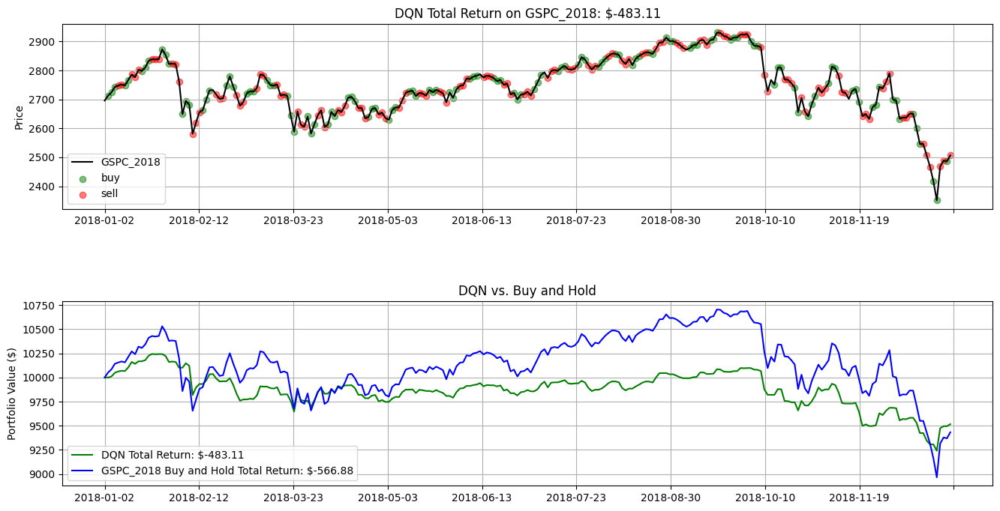

180


/tmp/ipykernel_4126/4161191421.py:66: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  self.model.load_state_dict(torch.load(f'models/{model_name}.pt' ))


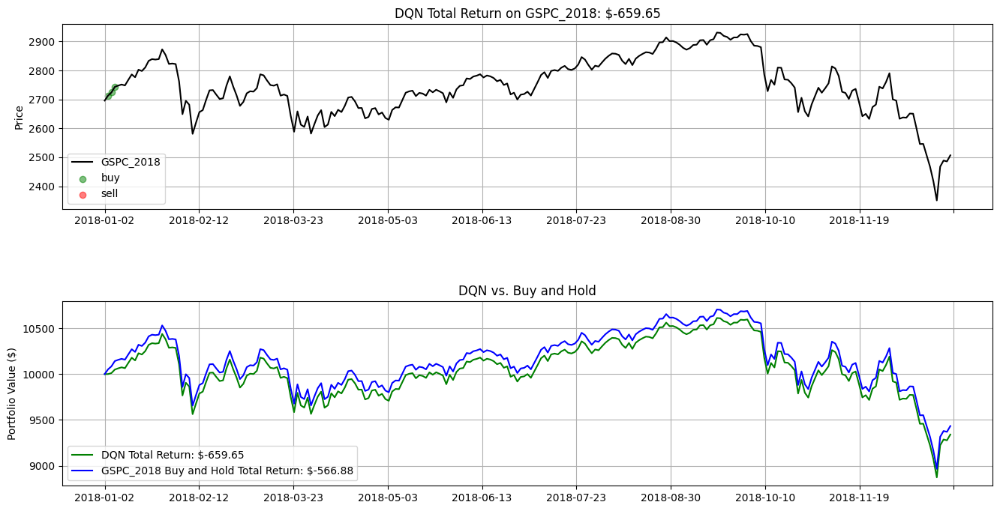

190
200


/tmp/ipykernel_4126/4161191421.py:66: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  self.model.load_state_dict(torch.load(f'models/{model_name}.pt' ))


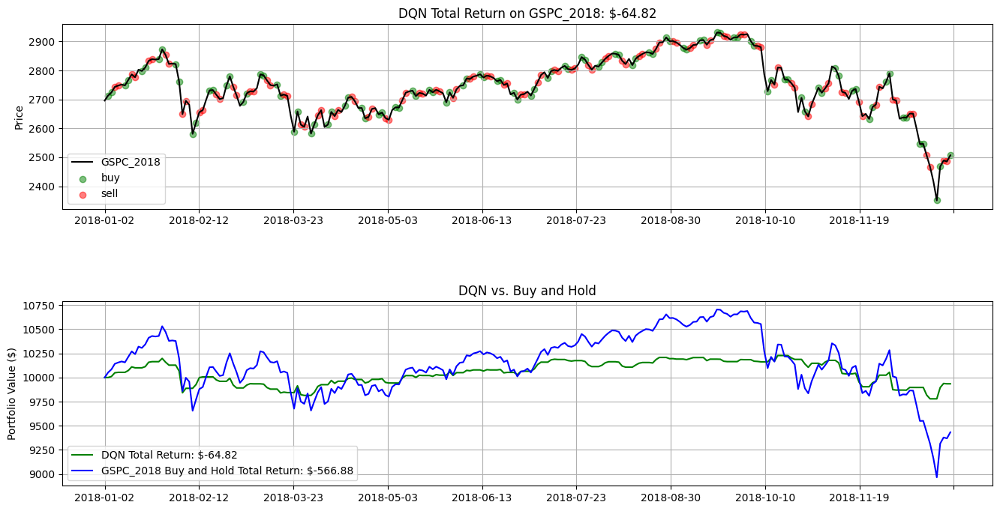

210
220
230


/tmp/ipykernel_4126/4161191421.py:66: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  self.model.load_state_dict(torch.load(f'models/{model_name}.pt' ))


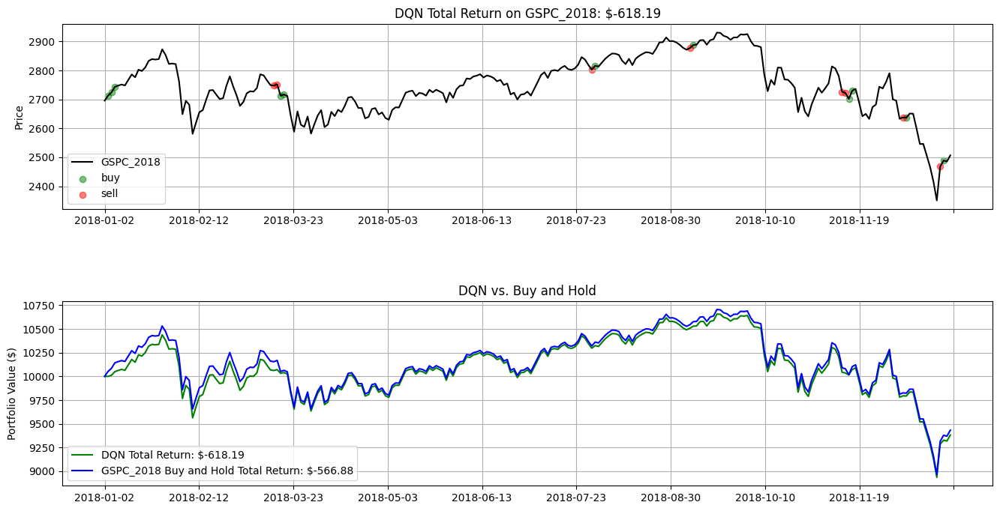

240
250
260


/tmp/ipykernel_4126/4161191421.py:66: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  self.model.load_state_dict(torch.load(f'models/{model_name}.pt' ))


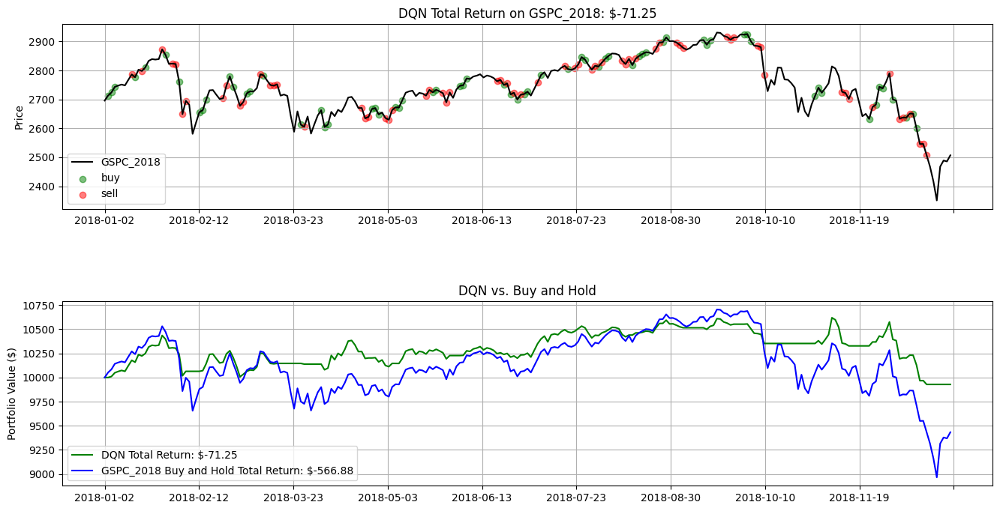

270


/tmp/ipykernel_4126/4161191421.py:66: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  self.model.load_state_dict(torch.load(f'models/{model_name}.pt' ))


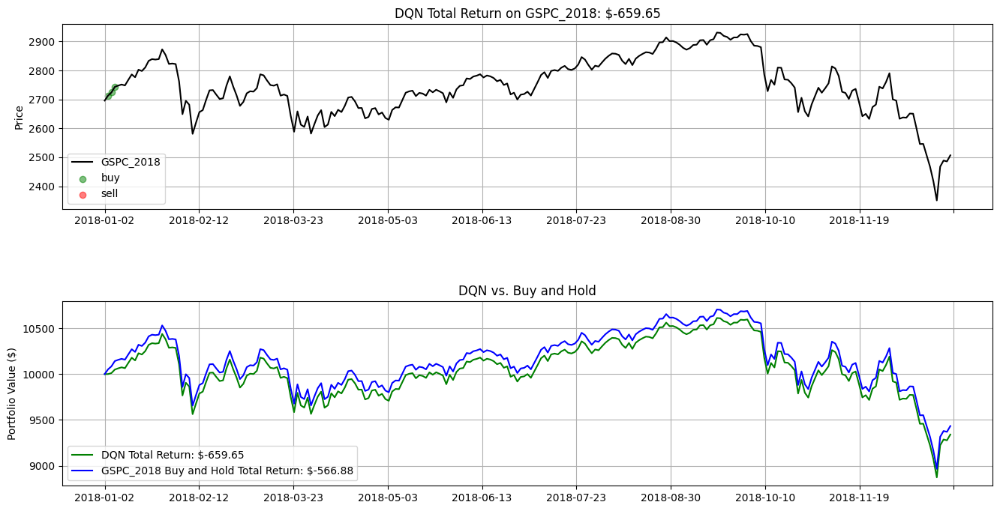

280
290


/tmp/ipykernel_4126/4161191421.py:66: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  self.model.load_state_dict(torch.load(f'models/{model_name}.pt' ))


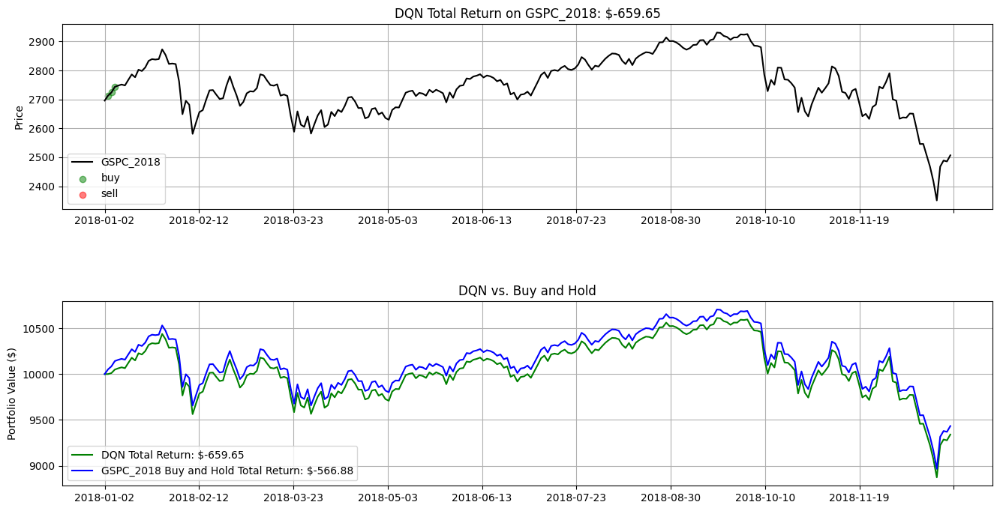

300


/tmp/ipykernel_4126/4161191421.py:66: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  self.model.load_state_dict(torch.load(f'models/{model_name}.pt' ))


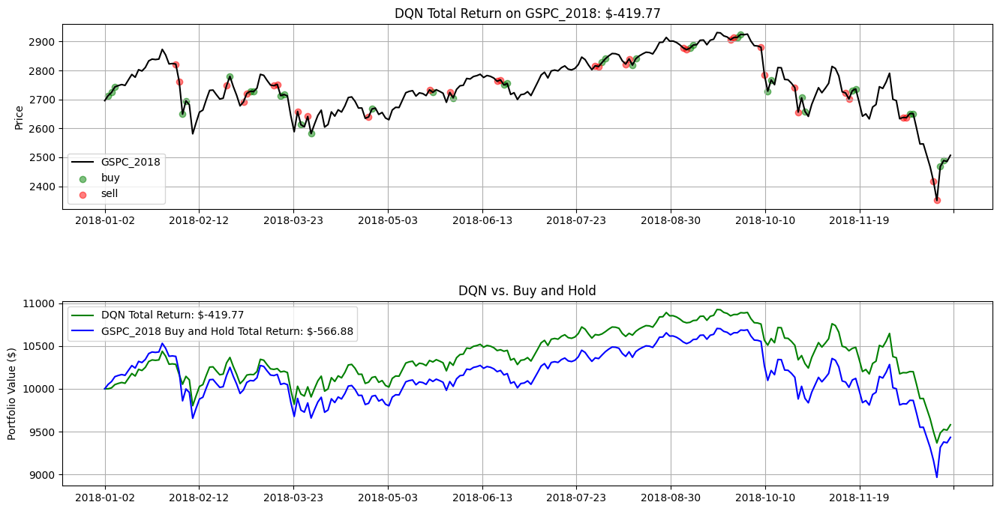

310
320
330
340
350
360


/tmp/ipykernel_4126/4161191421.py:66: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  self.model.load_state_dict(torch.load(f'models/{model_name}.pt' ))


370
380


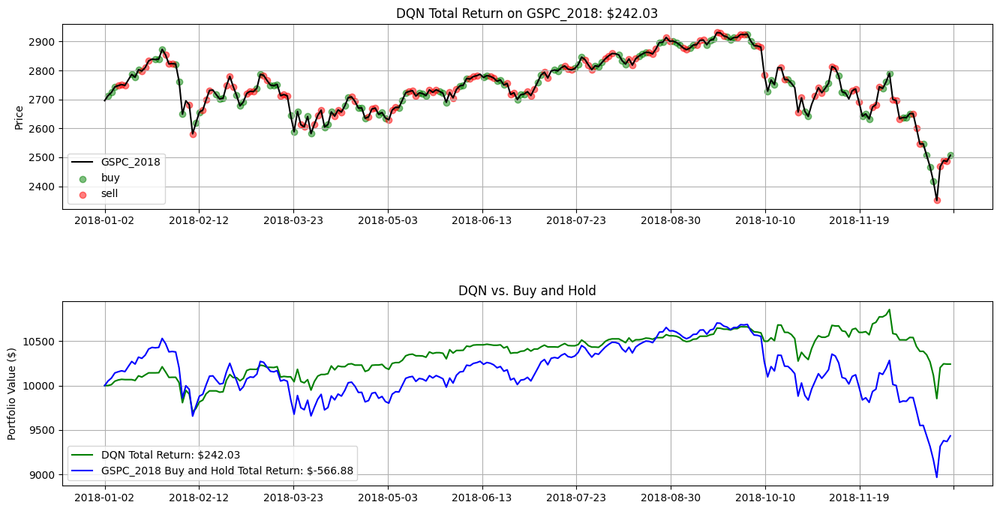

390
400
410
420
430


/tmp/ipykernel_4126/4161191421.py:66: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  self.model.load_state_dict(torch.load(f'models/{model_name}.pt' ))


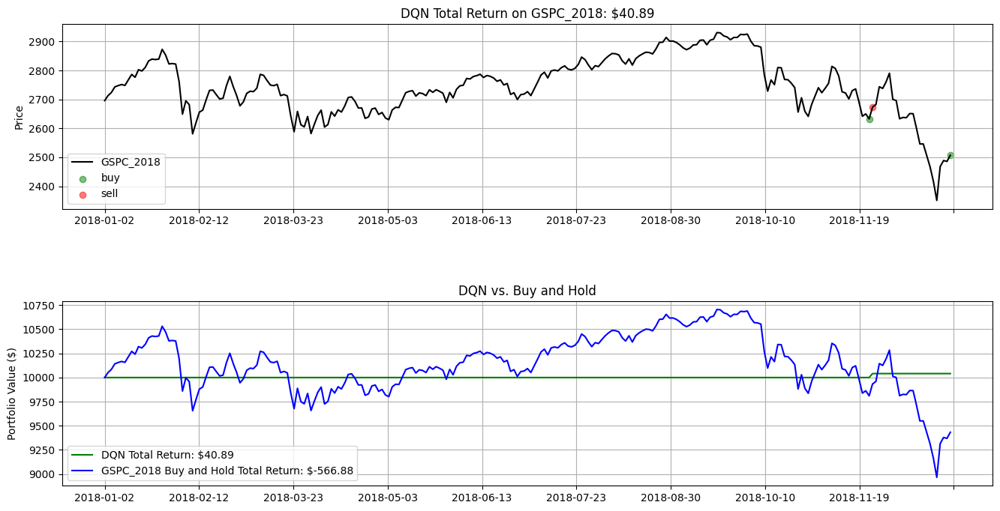

440
450


/tmp/ipykernel_4126/4161191421.py:66: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  self.model.load_state_dict(torch.load(f'models/{model_name}.pt' ))


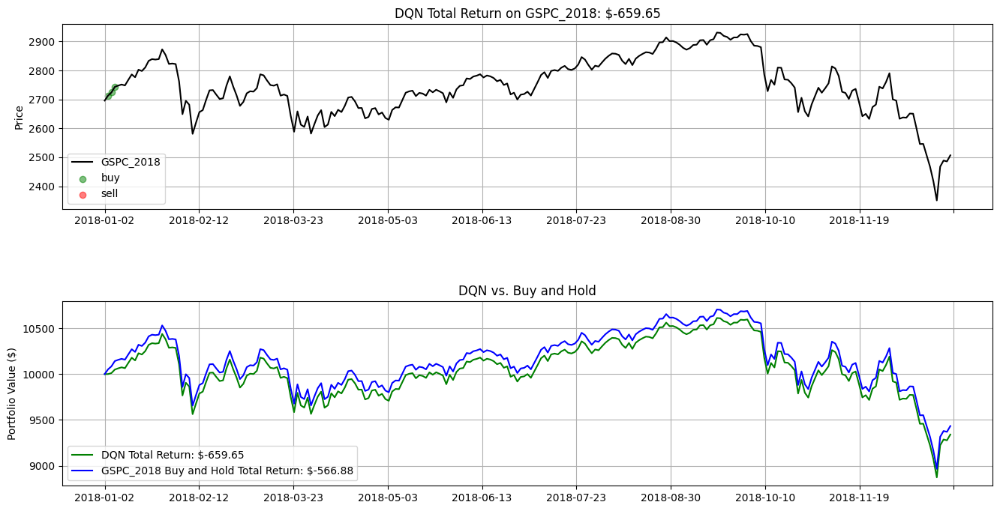

460
470
480


/tmp/ipykernel_4126/4161191421.py:66: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  self.model.load_state_dict(torch.load(f'models/{model_name}.pt' ))


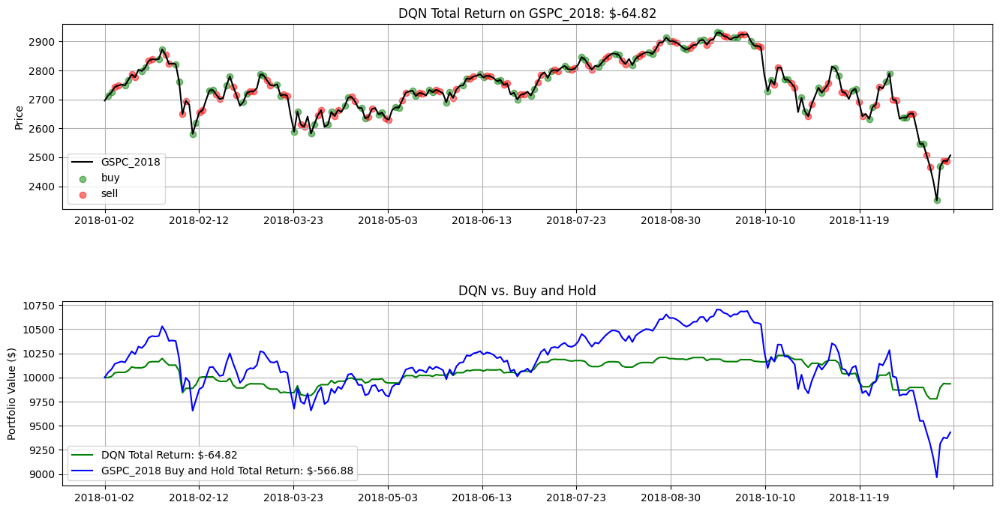

490


/tmp/ipykernel_4126/4161191421.py:66: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  self.model.load_state_dict(torch.load(f'models/{model_name}.pt' ))


In [38]:

#the evaluation code for the trained model 

#hold function for evaluation
def hold():
    pass


#buy function for evaluation
def buy(t):
    agent.balance -= stock_prices[t]
    agent.inventory.append(stock_prices[t])
    agent.buy_dates.append(t)


#sell function
def sell(t):
    agent.balance += stock_prices[t]
    bought_price = agent.inventory.pop()
    profit = stock_prices[t] - bought_price
    agent.sell_dates.append(t)

    global reward
    reward = profit

window_size = 10




for i in range ( 1 , 50):


    model_to_load = f"DQN_ep{10*i}"
    # stock_name = input('stock_name: ')
    stock_name = 'GSPC_2018'
    initial_balance = 10000
    display = True
    action_dict = {0: 'Hold', 1: 'Buy', 2: 'Sell'}

    agent = Agent(state_dim=window_size + 3, balance=initial_balance, is_eval=True, model_name=model_to_load)

    portfolio_return = 0
    stock_prices = stock_close_prices(stock_name)
    trading_period = len(stock_prices) - 1
    state = generate_combined_state(0, window_size, stock_prices, agent.balance, len(agent.inventory))

    for t in range(1, trading_period + 1):
        
        actions = agent.model(torch.FloatTensor(state).unsqueeze(0)).cpu().detach().numpy()[0]
        action = agent.act(state=state)

        next_state = generate_combined_state(end_index=t, window_size=window_size, stock_prices=stock_prices, balance=agent.balance, num_holding=len(agent.inventory) )
        previous_portfolio_value = len(agent.inventory) * stock_prices[t] + agent.balance
        
        # Execute position
        # print(f'Step: {t}')
        if action != np.argmax(actions): print(f"\t\t'{action_dict[action]}' is an exploration.")
        if action == 0:
            hold()  # hold
        elif action == 1 and agent.balance > stock_prices[t]:
            buy(t)  # buy
        elif action == 2 and len(agent.inventory) > 0:
            sell(t)  # sell

        current_portfolio_value = len(agent.inventory) * stock_prices[t] + agent.balance
        agent.return_rates.append((current_portfolio_value - previous_portfolio_value) / previous_portfolio_value)
        agent.portfolio_values.append(current_portfolio_value)
        state = next_state

        done = True if t == trading_period else False
        if done:
            portfolio_return = agent.portfolio_values[-1] - agent.initial_portfolio_value

    print("======")
    print(10*i)
    if display and portfolio_return!=0 :
        plot_all(stock_name=stock_name, agent=agent)
    print("======")
